<a href="https://colab.research.google.com/github/liuzh1720/ai-applied-in-transport/blob/Final_project/Final_Project_AH2179.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# Traffic flow/speed predict


## Data preprocessing

In [ ]:
import pandas as pd
import numpy as np

df = pd.read_csv("training_dataset.csv",sep=";")

df['Datetime'] = pd.to_datetime(df['Date'].astype(str) + ' ' + df['Time'].astype(str))
#print(df['Datetime'].head())
df.set_index('Datetime', inplace=True)
df = df_filtered = df.between_time('07:00', '08:30')
# Reset the index to make 'Datetime' a column again
df = df.reset_index()
df_grouped = df.groupby('PORTAL').resample('5T', on='Datetime').agg({
    'SPEED_MS_AVG': 'mean',
    'FLOW': 'sum',
    'Interval_5': 'first',
    'Interval_15': 'first',
    'Interval_30': 'first',
    'Interval_1': 'first',
    'Interval_60': 'first',
}).reset_index()

df = df_grouped = df_grouped.dropna()
df = df_encoded = pd.get_dummies(df_grouped, columns=['PORTAL'])
df = df.reset_index()

df


<ipython-input-227-b6c57bdaaa51>:12: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df_grouped = df.groupby('PORTAL').resample('5T', on='Datetime').agg({


,index,Datetime,SPEED_MS_AVG,FLOW,Interval_5,Interval_15,Interval_30,Interval_1,Interval_60,"PORTAL_E4S 55,620","PORTAL_E4S 56,160","PORTAL_E4S 56,490","PORTAL_E4S 56,780","PORTAL_E4S 57,055","PORTAL_E4S 57,435","PORTAL_E4S 57,820","PORTAL_E4S 58,140"
0,0,2021-06-01 07:00:00,18.130000,324.0,84.0,28.0,14.0,420.0,7.0,True,False,False,False,False,False,False,False
1,1,2021-06-01 07:05:00,18.826000,288.0,85.0,28.0,14.0,425.0,7.0,True,False,False,False,False,False,False,False
2,2,2021-06-01 07:10:00,18.714667,303.0,86.0,28.0,14.0,430.0,7.0,True,False,False,False,False,False,False,False
3,3,2021-06-01 07:15:00,20.514667,243.0,87.0,29.0,14.0,435.0,7.0,True,False,False,False,False,False,False,False
4,4,2021-06-01 07:20:00,20.148000,222.0,88.0,29.0,14.0,440.0,7.0,True,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31994,490899,2021-12-31 08:10:00,20.920625,39.0,98.0,32.0,16.0,490.0,8.0,False,False,False,False,False,False,False,True
31995,490900,2021-12-31 08:15:00,21.821111,37.0,99.0,33.0,16.0,495.0,8.0,False,False,False,False,False,False,False,True
31996,490901,2021-12-31 08:20:00,20.363750,34.0,100.0,33.0,16.0,500.0,8.0,False,False,False,False,False,False,False,True
31997,490902,2021-12-31 08:25:00,20.639500,60.0,101.0,33.0,16.0,505.0,8.0,False,False,False,False,False,False,False,True


### Delete outliers

In [ ]:
import numpy as np

threshold = 3

# Assuming 'FLOW' represents volume and 'SPEED_MS_AVG' represents speed
mean_volume = np.mean(df['FLOW'])  # Changed 'volume' to 'FLOW'
std_volume = np.std(df['FLOW'])    # Changed 'volume' to 'FLOW'
mean_speed = np.mean(df['SPEED_MS_AVG'])  # Changed 'speed' to 'SPEED_MS_AVG'
std_speed = np.std(df['SPEED_MS_AVG'])    # Changed 'speed' to 'SPEED_MS_AVG'

z_scores_volume = (df['FLOW'] - mean_volume) / std_volume  # Changed 'volume' to 'FLOW'
z_scores_speed = (df['SPEED_MS_AVG'] - mean_speed) / std_speed  # Changed 'speed' to 'SPEED_MS_AVG'

df = df_cleaned = df[(np.abs(z_scores_volume) <= threshold) & (np.abs(z_scores_speed) <= threshold)]

df

,index,Datetime,SPEED_MS_AVG,FLOW,Interval_5,Interval_15,Interval_30,Interval_1,Interval_60,"PORTAL_E4S 55,620","PORTAL_E4S 56,160","PORTAL_E4S 56,490","PORTAL_E4S 56,780","PORTAL_E4S 57,055","PORTAL_E4S 57,435","PORTAL_E4S 57,820","PORTAL_E4S 58,140"
0,0,2021-06-01 07:00:00,18.130000,324.0,84.0,28.0,14.0,420.0,7.0,True,False,False,False,False,False,False,False
1,1,2021-06-01 07:05:00,18.826000,288.0,85.0,28.0,14.0,425.0,7.0,True,False,False,False,False,False,False,False
2,2,2021-06-01 07:10:00,18.714667,303.0,86.0,28.0,14.0,430.0,7.0,True,False,False,False,False,False,False,False
3,3,2021-06-01 07:15:00,20.514667,243.0,87.0,29.0,14.0,435.0,7.0,True,False,False,False,False,False,False,False
4,4,2021-06-01 07:20:00,20.148000,222.0,88.0,29.0,14.0,440.0,7.0,True,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31994,490899,2021-12-31 08:10:00,20.920625,39.0,98.0,32.0,16.0,490.0,8.0,False,False,False,False,False,False,False,True
31995,490900,2021-12-31 08:15:00,21.821111,37.0,99.0,33.0,16.0,495.0,8.0,False,False,False,False,False,False,False,True
31996,490901,2021-12-31 08:20:00,20.363750,34.0,100.0,33.0,16.0,500.0,8.0,False,False,False,False,False,False,False,True
31997,490902,2021-12-31 08:25:00,20.639500,60.0,101.0,33.0,16.0,505.0,8.0,False,False,False,False,False,False,False,True


## Feature engineering

### Creat feature(weekend,month)

In [ ]:
df_encoded['Month'] = df_encoded['Datetime'].dt.month
df_encoded['Is_Weekend'] = df_encoded['Datetime'].dt.weekday >= 5
df = df_encoded
df

,Datetime,SPEED_MS_AVG,FLOW,Interval_5,Interval_15,Interval_30,Interval_1,Interval_60,"PORTAL_E4S 55,620","PORTAL_E4S 56,160","PORTAL_E4S 56,490","PORTAL_E4S 56,780","PORTAL_E4S 57,055","PORTAL_E4S 57,435","PORTAL_E4S 57,820","PORTAL_E4S 58,140",Month,Is_Weekend
0,2021-06-01 07:00:00,18.130000,324.0,84.0,28.0,14.0,420.0,7.0,True,False,False,False,False,False,False,False,6,False
1,2021-06-01 07:05:00,18.826000,288.0,85.0,28.0,14.0,425.0,7.0,True,False,False,False,False,False,False,False,6,False
2,2021-06-01 07:10:00,18.714667,303.0,86.0,28.0,14.0,430.0,7.0,True,False,False,False,False,False,False,False,6,False
3,2021-06-01 07:15:00,20.514667,243.0,87.0,29.0,14.0,435.0,7.0,True,False,False,False,False,False,False,False,6,False
4,2021-06-01 07:20:00,20.148000,222.0,88.0,29.0,14.0,440.0,7.0,True,False,False,False,False,False,False,False,6,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
490899,2021-12-31 08:10:00,20.920625,39.0,98.0,32.0,16.0,490.0,8.0,False,False,False,False,False,False,False,True,12,False
490900,2021-12-31 08:15:00,21.821111,37.0,99.0,33.0,16.0,495.0,8.0,False,False,False,False,False,False,False,True,12,False
490901,2021-12-31 08:20:00,20.363750,34.0,100.0,33.0,16.0,500.0,8.0,False,False,False,False,False,False,False,True,12,False
490902,2021-12-31 08:25:00,20.639500,60.0,101.0,33.0,16.0,505.0,8.0,False,False,False,False,False,False,False,True,12,False


### Creat feature(historic volume and speed)(and Mean and standard deviation of them)

In [ ]:
def create_lag_features(df, lag=6):
    for i in range(1, lag + 1):
        df[f'FLOW_LAG_{i}'] = df['FLOW'].shift(i)
        df[f'SPEED_LAG_{i}'] = df['SPEED_MS_AVG'].shift(i)
    return df

### Create rolling mean and standard deviation for FLOW and SPEED_MS_AVG.
def create_rolling_features(df, window=6):
    df[f'FLOW_MEAN_{window}'] = df['FLOW'].rolling(window=window).mean()
    df[f'FLOW_STD_{window}'] = df['FLOW'].rolling(window=window).std()
    df[f'SPEED_MEAN_{window}'] = df['SPEED_MS_AVG'].rolling(window=window).mean()
    df[f'SPEED_STD_{window}'] = df['SPEED_MS_AVG'].rolling(window=window).std()
    return df

def create_future_flow_sum(df, steps=3):
    df['TARGET_FLOW'] = df['FLOW'].shift(-1) + df['FLOW'].shift(-2) + df['FLOW'].shift(-3)
    return df

def create_future_speed_average(df, steps=3):
    df['TARGET_SPEED'] = (df['SPEED_MS_AVG'].shift(-1) + df['SPEED_MS_AVG'].shift(-2) + df['SPEED_MS_AVG'].shift(-3))/3
    return df

df_encoded = create_lag_features(df_encoded)
df_encoded = create_rolling_features(df_encoded, window=6)
df_encoded = create_future_flow_sum(df_encoded, steps=3)
df_encoded = create_future_speed_average(df_encoded, steps=3)

df = df_encoded
df

,Datetime,SPEED_MS_AVG,FLOW,Interval_5,Interval_15,Interval_30,Interval_1,Interval_60,"PORTAL_E4S 55,620","PORTAL_E4S 56,160",...,FLOW_LAG_5,SPEED_LAG_5,FLOW_LAG_6,SPEED_LAG_6,FLOW_MEAN_6,FLOW_STD_6,SPEED_MEAN_6,SPEED_STD_6,TARGET_FLOW,TARGET_SPEED
0,2021-06-01 07:00:00,18.130000,324.0,84.0,28.0,14.0,420.0,7.0,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,834.0,19.351778
1,2021-06-01 07:05:00,18.826000,288.0,85.0,28.0,14.0,425.0,7.0,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,768.0,19.792444
2,2021-06-01 07:10:00,18.714667,303.0,86.0,28.0,14.0,430.0,7.0,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,698.0,20.160222
3,2021-06-01 07:15:00,20.514667,243.0,87.0,29.0,14.0,435.0,7.0,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,683.0,20.058444
4,2021-06-01 07:20:00,20.148000,222.0,88.0,29.0,14.0,440.0,7.0,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,743.0,19.785111
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
490899,2021-12-31 08:10:00,20.920625,39.0,98.0,32.0,16.0,490.0,8.0,False,False,...,38.0,20.590000,45.0,20.031765,40.333333,2.160247,20.629410,0.380368,131.0,20.941454
490900,2021-12-31 08:15:00,21.821111,37.0,99.0,33.0,16.0,495.0,8.0,False,False,...,40.0,20.585556,38.0,20.590000,40.166667,2.401388,20.834595,0.614718,105.0,20.287750
490901,2021-12-31 08:20:00,20.363750,34.0,100.0,33.0,16.0,500.0,8.0,False,False,...,43.0,21.187222,40.0,20.585556,39.166667,3.488075,20.797627,0.638885,NaN,NaN
490902,2021-12-31 08:25:00,20.639500,60.0,101.0,33.0,16.0,505.0,8.0,False,False,...,43.0,20.370556,43.0,21.187222,42.000000,9.295160,20.706340,0.610588,NaN,NaN


## Data analysis

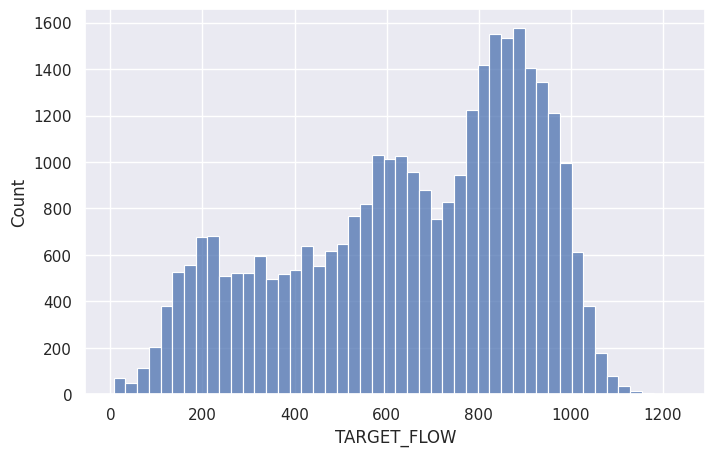

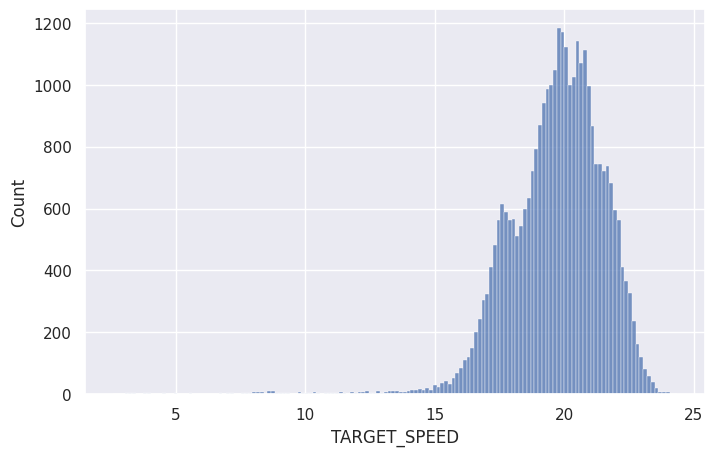

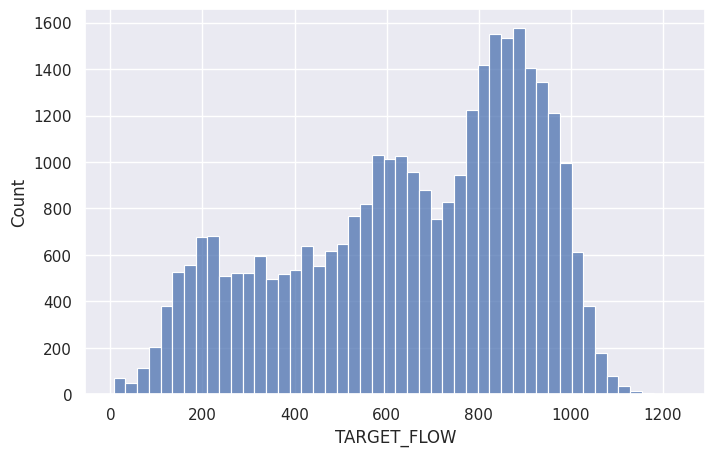

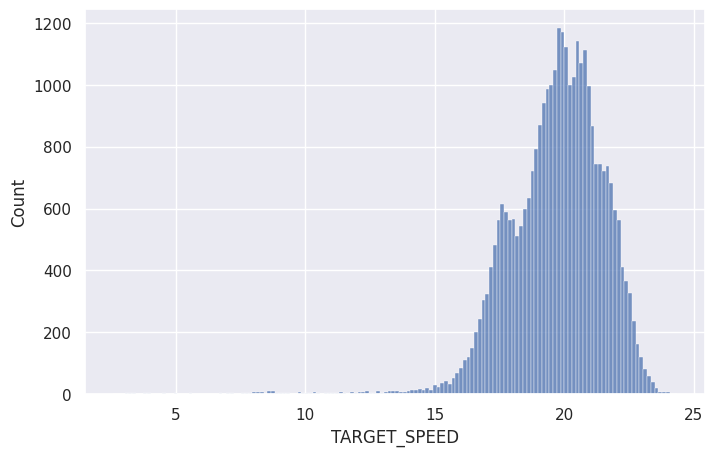

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

plt.figure(figsize=(8, 5))
sns.histplot(x=df['TARGET_FLOW'])
plt.show()

plt.figure(figsize=(8, 5))
sns.histplot(x=df['TARGET_SPEED'])
plt.show()

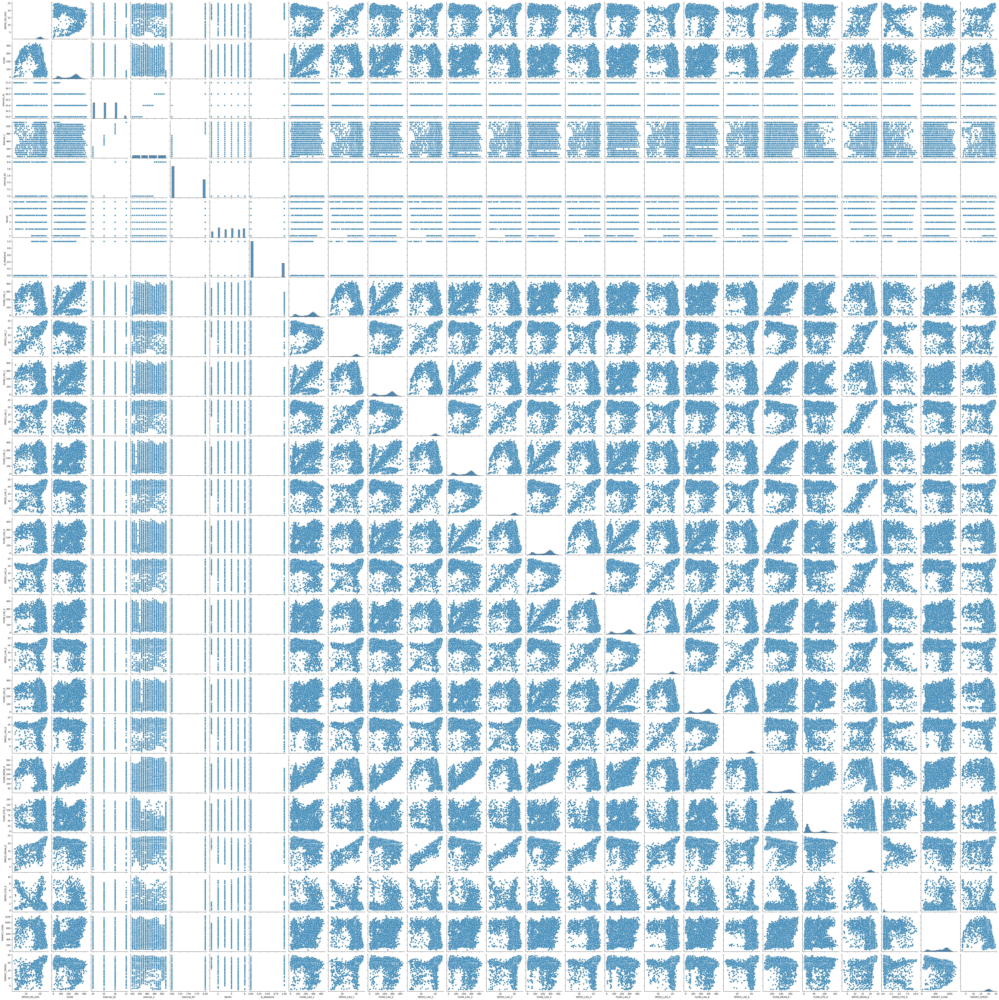

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
x = df.drop(['PORTAL_E4S 55,620','PORTAL_E4S 56,160','PORTAL_E4S 56,490',
             'PORTAL_E4S 56,780','PORTAL_E4S 57,055','PORTAL_E4S 57,435','PORTAL_E4S 57,820','PORTAL_E4S 58,140',
             'Interval_5','Interval_15','Datetime'], axis=1)

sns.pairplot(x)
plt.show()

## Split data by sensor location（optional）(BEST!!!)

In [ ]:
bule_sensors = ['PORTAL_E4S 57,055', 'PORTAL_E4S 57,435', 'PORTAL_E4S 57,820', 'PORTAL_E4S 58,140']
pink_sensors = ['PORTAL_E4S 56,490', 'PORTAL_E4S 56,780']
yellow_sensors = ['PORTAL_E4S 56,160']
green_sensors = ['PORTAL_E4S 55,620']

df_bule = df[df[bule_sensors].max(axis=1) == 1]
df_pink = df[df[pink_sensors].max(axis=1) == 1]
df_yellow = df[df[yellow_sensors].max(axis=1) == 1]
df_green = df[df[green_sensors].max(axis=1) == 1]

print(f"bule_sensors: {df_bule}")
print(f"pink_sensors: {df_pink}")
print(f"yellow_sensors: {df_yellow}")
print(f"green_sensors: {df_green}")


bule_sensors:                   Datetime  SPEED_MS_AVG   FLOW  Interval_5  Interval_15  \
245452 2021-06-01 07:00:00      9.610000  345.0        84.0         28.0   
245453 2021-06-01 07:05:00      9.145333  361.0        85.0         28.0   
245454 2021-06-01 07:10:00     12.072000  327.0        86.0         28.0   
245455 2021-06-01 07:15:00     17.528000  251.0        87.0         29.0   
245456 2021-06-01 07:20:00     17.438667  240.0        88.0         29.0   
...                    ...           ...    ...         ...          ...   
490899 2021-12-31 08:10:00     20.920625   39.0        98.0         32.0   
490900 2021-12-31 08:15:00     21.821111   37.0        99.0         33.0   
490901 2021-12-31 08:20:00     20.363750   34.0       100.0         33.0   
490902 2021-12-31 08:25:00     20.639500   60.0       101.0         33.0   
490903 2021-12-31 08:30:00     19.860000   11.0       102.0         34.0   

        Interval_30  Interval_1  Interval_60  PORTAL_E4S 55,620  \
245452

## Data Analysis For Each Area

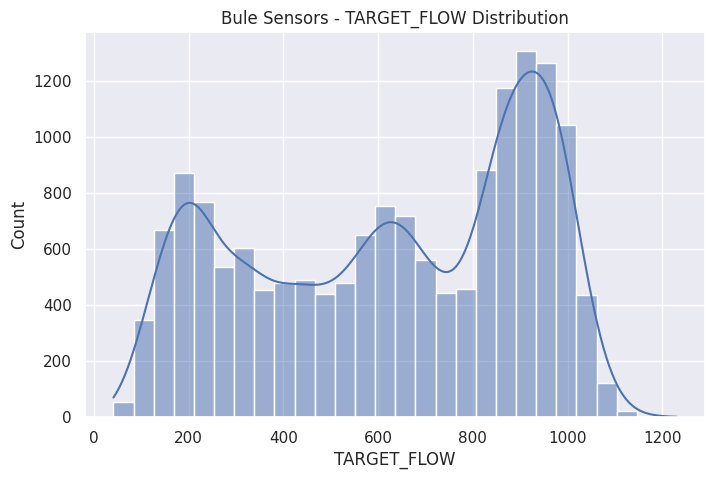

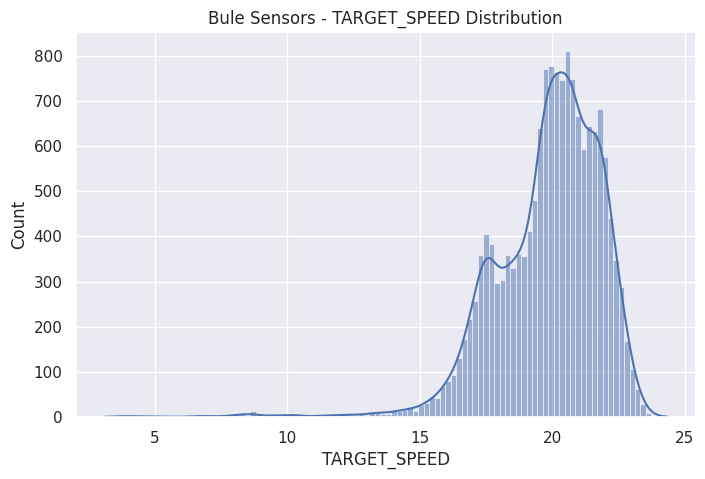

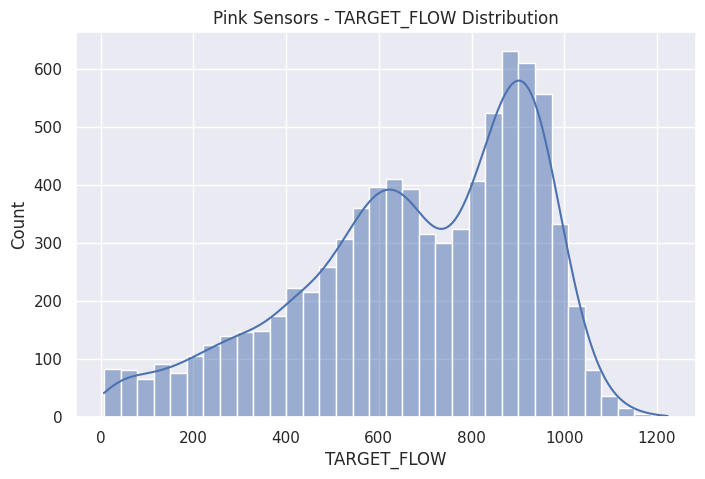

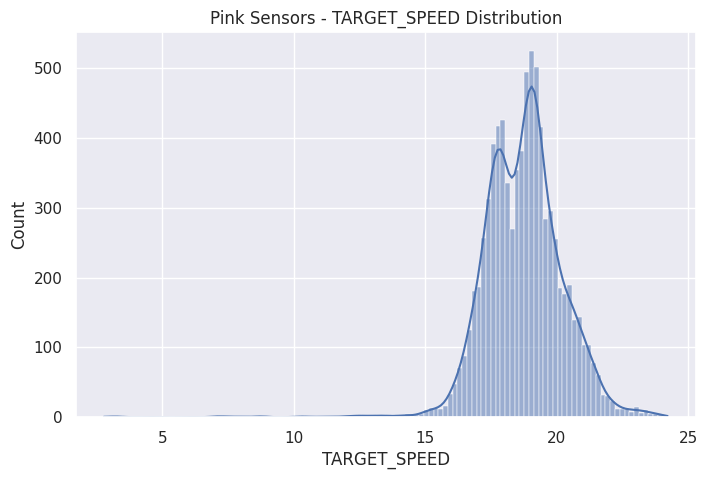

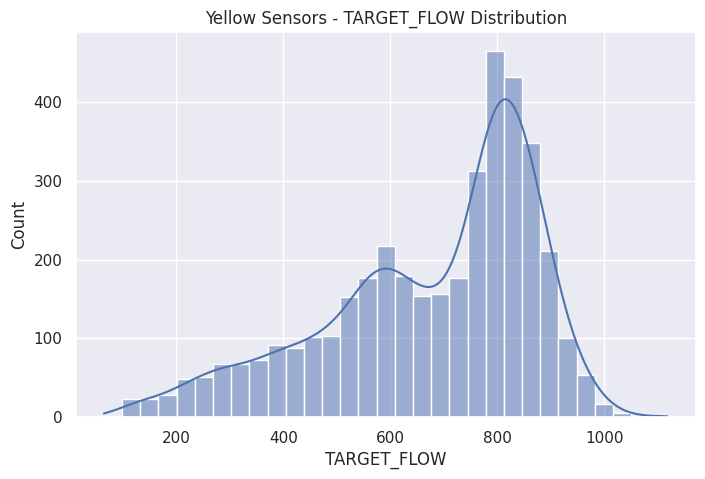

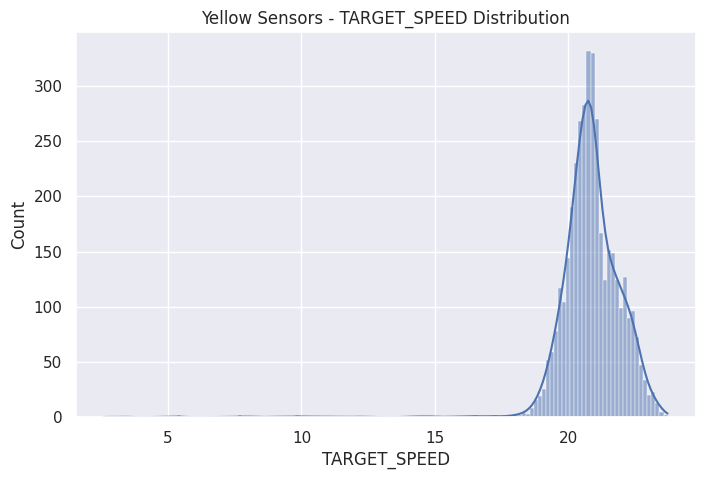

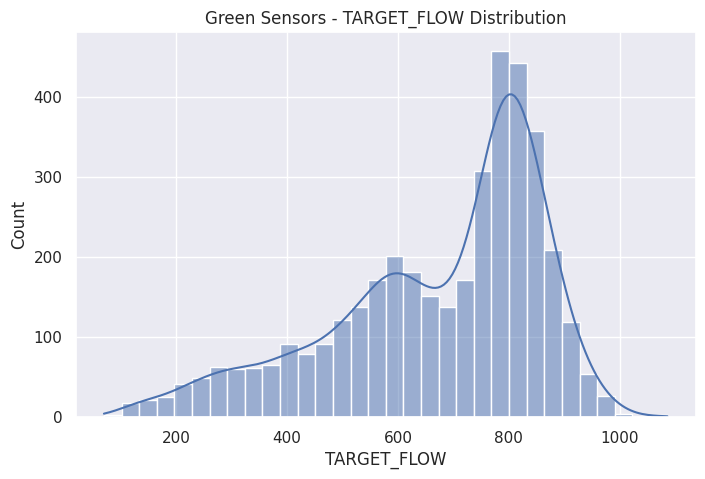

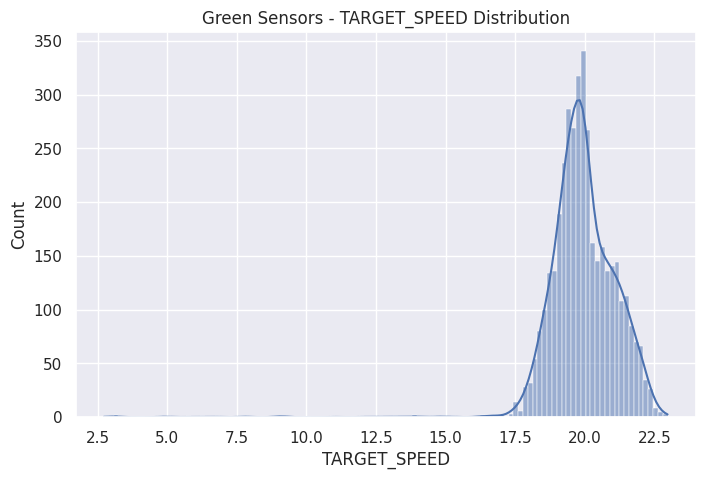

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set()

# bule
plt.figure(figsize=(8, 5))
sns.histplot(x=df_bule['TARGET_FLOW'], kde=True)
plt.title('Bule Sensors - TARGET_FLOW Distribution')
plt.show()

plt.figure(figsize=(8, 5))
sns.histplot(x=df_bule['TARGET_SPEED'], kde=True)
plt.title('Bule Sensors - TARGET_SPEED Distribution')
plt.show()

# pink
plt.figure(figsize=(8, 5))
sns.histplot(x=df_pink['TARGET_FLOW'], kde=True)
plt.title('Pink Sensors - TARGET_FLOW Distribution')
plt.show()

plt.figure(figsize=(8, 5))
sns.histplot(x=df_pink['TARGET_SPEED'], kde=True)
plt.title('Pink Sensors - TARGET_SPEED Distribution')
plt.show()

# yellow
plt.figure(figsize=(8, 5))
sns.histplot(x=df_yellow['TARGET_FLOW'], kde=True)
plt.title('Yellow Sensors - TARGET_FLOW Distribution')
plt.show()

plt.figure(figsize=(8, 5))
sns.histplot(x=df_yellow['TARGET_SPEED'], kde=True)
plt.title('Yellow Sensors - TARGET_SPEED Distribution')
plt.show()

# green
plt.figure(figsize=(8, 5))
sns.histplot(x=df_green['TARGET_FLOW'], kde=True)
plt.title('Green Sensors - TARGET_FLOW Distribution')
plt.show()

plt.figure(figsize=(8, 5))
sns.histplot(x=df_green['TARGET_SPEED'], kde=True)
plt.title('Green Sensors - TARGET_SPEED Distribution')
plt.show()

## **Choose the Area:**

In [ ]:
## choose the portal

#df = df_bule
#df = df_pink
df = df_yellow
#df = df_green

## Train / Test Split

In [ ]:
from sklearn.model_selection import train_test_split
x = df.drop(['TARGET_SPEED','TARGET_FLOW','Datetime','PORTAL_E4S 55,620','PORTAL_E4S 56,160','PORTAL_E4S 56,490',
             'PORTAL_E4S 56,780','PORTAL_E4S 57,055','PORTAL_E4S 57,435','PORTAL_E4S 57,820','PORTAL_E4S 58,140'], axis=1)
y1 = df['TARGET_FLOW']
y2 = df['TARGET_SPEED']
X_train, X_test, y1_train, y1_test, y2_train, y2_test = train_test_split(x, y1, y2, test_size=0.2, random_state=42)

## Normalization and drop NAN

In [ ]:
from sklearn.preprocessing import StandardScaler


X_train.dropna(inplace=True)
y1_train.dropna(inplace=True)
y2_train.dropna(inplace=True)
X_test.dropna(inplace=True)
y1_test.dropna(inplace=True)
y2_test.dropna(inplace=True)


common_index_train = X_train.index.intersection(y1_train.index).intersection(y2_train.index)
common_index_test = X_test.index.intersection(y1_test.index).intersection(y2_test.index)

X_train = X_train.loc[common_index_train]
y1_train = y1_train.loc[common_index_train]
y2_train = y2_train.loc[common_index_train]

X_test = X_test.loc[common_index_test]
y1_test = y1_test.loc[common_index_test]
y2_test = y2_test.loc[common_index_test]


# Normalization
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

## Dimensionality

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components='mle', svd_solver='full') #automaticlly find the best components
X_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)

print("Original X_train shape:", X_train.shape)
print("Original X_test shape:", X_test.shape)
print("Transformed X_pca shape:", X_pca.shape)
print("Transformed X_test_pca shape:", X_test_pca.shape)

Original X_train shape: (3140, 25)
Original X_test shape: (785, 25)
Transformed X_pca shape: (3140, 23)
Transformed X_test_pca shape: (785, 23)


## Regression

### Create a linear regression model

In [ ]:
from sklearn.linear_model import LinearRegression
import joblib

# Create a Linear Regression model
model_volume = LinearRegression()
model_speed = LinearRegression()

# Fit the model to the training data
model_volume.fit(X_pca, y1_train)
model_speed.fit(X_pca, y2_train)

# Predict the test data with the fitted model
y1_pred = model_volume.predict(X_test_pca)
y2_pred = model_speed.predict(X_test_pca)
joblib.dump(model_speed, 'model_speed_yellow.pkl')

['model_speed_yellow.pkl']

### Evaluate the model

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

mae_volume = mean_absolute_error(y1_test, y1_pred)
mse_volume = mean_squared_error(y1_test, y1_pred)
r2_volume = r2_score(y1_test, y1_pred)

mae_speed = mean_absolute_error(y2_test, y2_pred)
mse_speed = mean_squared_error(y2_test, y2_pred)
r2_speed = r2_score(y2_test, y2_pred)

print('Evaluation for volume')
print(f"Mean Absolute Error: {mae_volume}")
print(f"Mean Squared Error: {mse_volume}")
print(f"R-squared: {r2_volume}")

print('Evaluation for speed')
print(f"Mean Absolute Error: {mae_speed}")
print(f"Mean Squared Error: {mse_speed}")
print(f"R-squared: {r2_speed}")

Evaluation for volume
Mean Absolute Error: 79.0667982004045
Mean Squared Error: 11164.661210628015
R-squared: 0.7134343097231391
Evaluation for speed
Mean Absolute Error: 0.45866574491798506
Mean Squared Error: 0.697917808019602
R-squared: 0.6922356821262348


## SVM

### GrideSearch

In [ ]:
## GrideSearch for volume predict model
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVR

# Define a parameter grid for hyperparameter tuning
param_grid_volume = {
    'kernel': ['linear', 'poly', 'rbf'],
    'C': [0.1, 1, 10],
    'epsilon': [0.01, 0.1, 1, 10]
}

# Create the GridSearchCV object
grid_search_volume = GridSearchCV(SVR(), param_grid_volume, cv=3, verbose=2,  n_jobs=-1)

# Fit the grid search to the scaled training data
grid_search_volume.fit(X_pca, y1_train)

# Get the best parameters
best_params_volume = grid_search_volume.best_params_

print("Best Parameters for volume:", best_params_volume)
print("Best Score for volume:", grid_search_volume.best_score_)

Fitting 3 folds for each of 36 candidates, totalling 108 fits
Best Parameters for volume: {'C': 10, 'epsilon': 0.01, 'kernel': 'rbf'}
Best Score for volume: 0.8870866501964416


In [ ]:
## GrideSearch for speed predict model
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVR

# Define a parameter grid for hyperparameter tuning
param_grid_speed = {
    'kernel': ['linear', 'poly', 'rbf'],
    'C': [0.1, 1, 10],
    'epsilon': [0.01, 0.1, 1, 10]
}

# Create the GridSearchCV object
grid_search_speed = GridSearchCV(SVR(), param_grid_speed, cv=3, verbose=2, n_jobs=-1)

# Fit the grid search to the scaled training data
grid_search_speed.fit(X_pca, y2_train)

# Get the best parameters
best_params_speed = grid_search_speed.best_params_

print("Best Parameters for speed:", best_params_speed)
print("Best Score for speed:", grid_search_speed.best_score_)

Fitting 3 folds for each of 36 candidates, totalling 108 fits
Best Parameters for speed: {'C': 10, 'epsilon': 0.1, 'kernel': 'rbf'}
Best Score for speed: 0.8494291240312837


### Creat SVR Model

In [ ]:
# Create an SVR model with the best parameters from the grid search
best_svr_volume = SVR(kernel=best_params_volume['kernel'], C=best_params_volume['C'], epsilon=best_params_volume['epsilon'])
best_svr_volume.fit(X_pca, y1_train)

best_svr_speed = SVR(kernel=best_params_speed['kernel'], C=best_params_speed['C'], epsilon=best_params_speed['epsilon'])
best_svr_speed.fit(X_pca, y2_train)


SVR(C=10)

### Evaluate Models

In [ ]:
y1_pred = best_svr_volume.predict(X_test_pca)
mae_volume = mean_absolute_error(y1_test, y1_pred)
mse_volume = mean_squared_error(y1_test, y1_pred)
r2_volume = r2_score(y1_test, y1_pred)
print(f"Mean Absolute Error for volume: {mae_volume}")
print(f"Mean Squared Error for volume: {mse_volume}")
print(f"R-squared for volume: {r2_volume}")

y2_pred = best_svr_speed.predict(X_test_pca)
mae_speed = mean_absolute_error(y2_test, y2_pred)
mse_speed = mean_squared_error(y2_test, y2_pred)
r2_speed = r2_score(y2_test, y2_pred)
print(f"Mean Absolute Error for speed: {mae_speed}")
print(f"Mean Squared Error for speed: {mse_speed}")
print(f"R-squared for speed: {r2_speed}")

Mean Absolute Error for volume: 59.122524059241044
Mean Squared Error for volume: 10144.342943916341
R-squared for volume: 0.8814025773715133
Mean Absolute Error for speed: 0.37359005505580084
Mean Squared Error for speed: 0.607607350211045
R-squared for speed: 0.8750936824068591


### Visualization

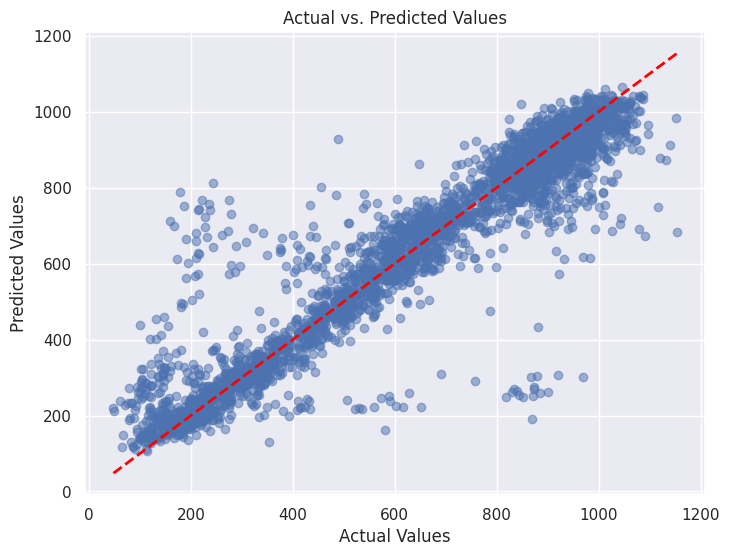

In [ ]:
## Plot for volume predict model

# Create a scatter plot to visualize the relationship
plt.figure(figsize=(8, 6))
plt.scatter(y1_test, y1_pred, alpha=0.5)  # Plot actual vs. predicted values

# Add labels and title
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Actual vs. Predicted Values")

# Add a diagonal line for reference (perfect predictions)
plt.plot([min(y1_test), max(y1_test)], [min(y1_test), max(y1_test)], linestyle='--', color='red', lw=2)

# Show the plot
plt.show()

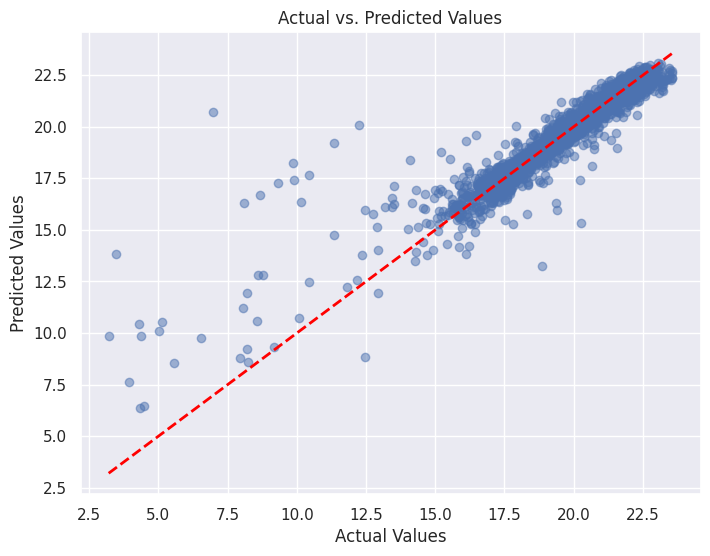

In [ ]:
## Plot for speed predict model

# Create a scatter plot to visualize the relationship
plt.figure(figsize=(8, 6))
plt.scatter(y2_test, y2_pred, alpha=0.5)  # Plot actual vs. predicted values

# Add labels and title
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Actual vs. Predicted Values")

# Add a diagonal line for reference (perfect predictions)
plt.plot([min(y2_test), max(y2_test)], [min(y2_test), max(y2_test)], linestyle='--', color='red', lw=2)

# Show the plot
plt.show()

## XGB

### GridSearch

In [ ]:
import xgboost as xgb
import numpy as np
from sklearn.model_selection import GridSearchCV

xgb_model = xgb.XGBRegressor(objective='reg:squarederror', eval_metric='rmse', nthread=4)

param_grid = {
    'max_depth': np.arange(3,10,1),  # Maximum depth of trees
    'eta': np.arange(0.3,0.1-0.05,-0.05),  # Learning rate
    'n_estimators': np.arange(100,1000,100)  #Number of boosting rounds
}

grid_search_xgb_volume = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=3, verbose=1, n_jobs=-1)
grid_search_xgb_volume.fit(X_pca, y1_train)

grid_search_xgb_speed = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=3, verbose=1, n_jobs=-1)
grid_search_xgb_speed.fit(X_pca, y2_train)

print(f'Best Parameters for volume predict model: {grid_search_xgb_volume.best_params_}')
print(f'Best Score (RMSE) for volume predict model: {grid_search_xgb_volume.best_score_}')

print(f'Best Parameters for speed predict model: {grid_search_xgb_speed.best_params_}')
print(f'Best Score (RMSE) for speed predict model: {grid_search_xgb_speed.best_score_}')

Fitting 3 folds for each of 315 candidates, totalling 945 fits
Fitting 3 folds for each of 315 candidates, totalling 945 fits


KeyboardInterrupt: 

### Creat XGB Models

In [ ]:
best_model_xgb_volume = grid_search_xgb_volume.best_estimator_
y1_pred = best_model_xgb_volume.predict(X_test_pca)

best_model_xgb_speed = grid_search_xgb_speed.best_estimator_
y2_pred = best_model_xgb_speed.predict(X_test_pca)

NameError: name 'grid_search_xgb_volume' is not defined

### Evaluate Models

In [ ]:
y1_pred = best_svr_volume.predict(X_test_pca)
mae_volume = mean_absolute_error(y1_test, y1_pred)
mse_volume = mean_squared_error(y1_test, y1_pred)
r2_volume = r2_score(y1_test, y1_pred)
print(f"Mean Absolute Error for volume: {mae_volume}")
print(f"Mean Squared Error for volume: {mse_volume}")
print(f"R-squared for volume: {r2_volume}")

y2_pred = best_svr_speed.predict(X_test_pca)
mae_speed = mean_absolute_error(y2_test, y2_pred)
mse_speed = mean_squared_error(y2_test, y2_pred)
r2_speed = r2_score(y2_test, y2_pred)
print(f"Mean Absolute Error for speed: {mae_speed}")
print(f"Mean Squared Error for speed: {mse_speed}")
print(f"R-squared for speed: {r2_speed}")


### Visualization

In [ ]:
## Plot for volume predict model

# Create a scatter plot to visualize the relationship
plt.figure(figsize=(8, 6))
plt.scatter(y1_test, y1_pred, alpha=0.5)  # Plot actual vs. predicted values

# Add labels and title
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Actual vs. Predicted Values")

# Add a diagonal line for reference (perfect predictions)
plt.plot([min(y1_test), max(y1_test)], [min(y1_test), max(y1_test)], linestyle='--', color='red', lw=2)

# Show the plot
plt.show()

In [ ]:
## Plot for speed predict model

# Create a scatter plot to visualize the relationship
plt.figure(figsize=(8, 6))
plt.scatter(y2_test, y2_pred, alpha=0.5)  # Plot actual vs. predicted values

# Add labels and title
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Actual vs. Predicted Values")

# Add a diagonal line for reference (perfect predictions)
plt.plot([min(y2_test), max(y2_test)], [min(y2_test), max(y2_test)], linestyle='--', color='red', lw=2)

# Show the plot
plt.show()

## Neural Network

### Load parameters

In [ ]:
params_df = pd.read_excel('/content/NN_parameters.xlsx')

### volume predict NN model

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

results = []  # List to store evaluation results

for index, row in params_df.iterrows():
    if index < 2:
        continue

    # Extract parameters from the current row
    hidden_layer1_size = int(row['Model'])  # Hidden_layer1
    hidden_layer2_size = int(row['Unnamed: 1'])  # Hidden_layer2
    dropout_rate = float(row['Unnamed: 2'])  # Dropout
    activation_function = row['Unnamed: 3']  # Activation Function
    batch_size = int(row['Unnamed: 4'])  # Batch Size

    # Create and compile the model based on the parameters
    model = Sequential()
    model.add(Dense(hidden_layer1_size, activation=activation_function, input_dim=X_pca.shape[1]))
    model.add(Dropout(dropout_rate))
    model.add(Dense(hidden_layer2_size, activation=activation_function))
    model.add(Dropout(dropout_rate))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mae', metrics=['mae'])

    # Train the model with early stopping and reduced learning rate
    early_stop = EarlyStopping(monitor='val_mae', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_mae', factor=0.5, patience=3)
    model.fit(X_pca, y1_train, validation_split=0.2, epochs=50, batch_size=batch_size,
              callbacks=[early_stop, reduce_lr], verbose=0)

    # Make predictions
    y1_pred = model.predict(X_test_pca)

    # Calculate metrics
    mae = mean_absolute_error(y1_test, y1_pred)
    mse = mean_squared_error(y1_test, y1_pred)
    r2 = r2_score(y1_test, y1_pred)

    # Append results to list (to add them to the dataframe later)
    results.append([mae, mse, r2])


for i, (mae, mse, r2) in enumerate(results):
    params_df.loc[i, 'MAE'] = mae
    params_df.loc[i, 'MSE'] = mse
    params_df.loc[i, 'R-Squared'] = r2

results
# Save the evaluation to excel
output_file_path = '/content/NN_result_volume.xlsx'
params_df.to_excel(output_file_path, index=False)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


101/101 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


### speed predict NN model

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

results = []  # List to store evaluation results

for index, row in params_df.iterrows():
    if index < 2:
        continue

    # Extract parameters from the current row
    hidden_layer1_size = int(row['Model'])  # Hidden_layer1
    hidden_layer2_size = int(row['Unnamed: 1'])  # Hidden_layer2
    dropout_rate = float(row['Unnamed: 2'])  # Dropout
    activation_function = row['Unnamed: 3']  # Activation Function
    batch_size = int(row['Unnamed: 4'])  # Batch Size

    # Create and compile the model based on the parameters
    model = Sequential()
    model.add(Dense(hidden_layer1_size, activation=activation_function, input_dim=X_pca.shape[1]))
    model.add(Dropout(dropout_rate))
    model.add(Dense(hidden_layer2_size, activation=activation_function))
    model.add(Dropout(dropout_rate))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mae', metrics=['mae'])

    # Train the model with early stopping and reduced learning rate
    early_stop = EarlyStopping(monitor='val_mae', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_mae', factor=0.5, patience=3)
    model.fit(X_pca, y2_train, validation_split=0.2, epochs=50, batch_size=batch_size,
              callbacks=[early_stop, reduce_lr], verbose=0)

    # Make predictions
    y2_pred = model.predict(X_test_pca)

    # Calculate metrics
    mae = mean_absolute_error(y2_test, y2_pred)
    mse = mean_squared_error(y2_test, y2_pred)
    r2 = r2_score(y2_test, y2_pred)

    # Append results to list (to add them to the dataframe later)
    results.append([mae, mse, r2])


for i, (mae, mse, r2) in enumerate(results):
    params_df.loc[i, 'MAE'] = mae
    params_df.loc[i, 'MSE'] = mse
    params_df.loc[i, 'R-Squared'] = r2

results
# Save the evaluation to excel
output_file_path = '/content/NN_result_speed.xlsx'
params_df.to_excel(output_file_path, index=False)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


# Final Evaluation

## Data preprocessing

In [ ]:
import pandas as pd
import numpy as np

df = pd.read_csv("final_evaluation_dataset.csv",sep=";")

df['Datetime'] = pd.to_datetime(df['Date'].astype(str) + ' ' + df['Time'].astype(str))
#print(df['Datetime'].head())
df.set_index('Datetime', inplace=True)
df = df_filtered = df.between_time('07:00', '08:30')
# Reset the index to make 'Datetime' a column again
df = df.reset_index()
df_grouped = df.groupby('PORTAL').resample('5T', on='Datetime').agg({
    'SPEED_MS_AVG': 'mean',
    'FLOW': 'sum',
    'Interval_5': 'first',
    'Interval_15': 'first',
    'Interval_30': 'first',
    'Interval_1': 'first',
    'Interval_60': 'first',
}).reset_index()

df = df_grouped = df_grouped.dropna()
df = df_encoded = pd.get_dummies(df_grouped, columns=['PORTAL'])
df = df.reset_index()

df


<ipython-input-1-b4f5276a58b6>:12: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df_grouped = df.groupby('PORTAL').resample('5T', on='Datetime').agg({


,index,Datetime,SPEED_MS_AVG,FLOW,Interval_5,Interval_15,Interval_30,Interval_1,Interval_60,"PORTAL_E4S 55,620","PORTAL_E4S 56,160","PORTAL_E4S 56,490","PORTAL_E4S 56,780","PORTAL_E4S 57,055","PORTAL_E4S 57,435","PORTAL_E4S 57,820","PORTAL_E4S 58,140"
0,0,2022-01-05 07:00:00,20.141333,208.0,84.0,28.0,14.0,420.0,7.0,True,False,False,False,False,False,False,False
1,1,2022-01-05 07:05:00,20.587333,152.0,85.0,28.0,14.0,425.0,7.0,True,False,False,False,False,False,False,False
2,2,2022-01-05 07:10:00,19.980667,176.0,86.0,28.0,14.0,430.0,7.0,True,False,False,False,False,False,False,False
3,3,2022-01-05 07:15:00,20.420000,180.0,87.0,29.0,14.0,435.0,7.0,True,False,False,False,False,False,False,False
4,4,2022-01-05 07:20:00,20.080667,172.0,88.0,29.0,14.0,440.0,7.0,True,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13174,393267,2022-06-30 08:10:00,21.233043,305.0,98.0,32.0,16.0,490.0,8.0,False,False,False,False,False,False,False,True
13175,393268,2022-06-30 08:15:00,20.611600,311.0,99.0,33.0,16.0,495.0,8.0,False,False,False,False,False,False,False,True
13176,393269,2022-06-30 08:20:00,20.556250,329.0,100.0,33.0,16.0,500.0,8.0,False,False,False,False,False,False,False,True
13177,393270,2022-06-30 08:25:00,20.600800,304.0,101.0,33.0,16.0,505.0,8.0,False,False,False,False,False,False,False,True


### Delete outliers

In [ ]:
import numpy as np

threshold = 3

# Assuming 'FLOW' represents volume and 'SPEED_MS_AVG' represents speed
mean_volume = np.mean(df['FLOW'])  # Changed 'volume' to 'FLOW'
std_volume = np.std(df['FLOW'])    # Changed 'volume' to 'FLOW'
mean_speed = np.mean(df['SPEED_MS_AVG'])  # Changed 'speed' to 'SPEED_MS_AVG'
std_speed = np.std(df['SPEED_MS_AVG'])    # Changed 'speed' to 'SPEED_MS_AVG'

z_scores_volume = (df['FLOW'] - mean_volume) / std_volume  # Changed 'volume' to 'FLOW'
z_scores_speed = (df['SPEED_MS_AVG'] - mean_speed) / std_speed  # Changed 'speed' to 'SPEED_MS_AVG'

df = df_cleaned = df[(np.abs(z_scores_volume) <= threshold) & (np.abs(z_scores_speed) <= threshold)]

df

,index,Datetime,SPEED_MS_AVG,FLOW,Interval_5,Interval_15,Interval_30,Interval_1,Interval_60,"PORTAL_E4S 55,620","PORTAL_E4S 56,160","PORTAL_E4S 56,490","PORTAL_E4S 56,780","PORTAL_E4S 57,055","PORTAL_E4S 57,435","PORTAL_E4S 57,820","PORTAL_E4S 58,140"
0,0,2022-01-05 07:00:00,20.141333,208.0,84.0,28.0,14.0,420.0,7.0,True,False,False,False,False,False,False,False
1,1,2022-01-05 07:05:00,20.587333,152.0,85.0,28.0,14.0,425.0,7.0,True,False,False,False,False,False,False,False
2,2,2022-01-05 07:10:00,19.980667,176.0,86.0,28.0,14.0,430.0,7.0,True,False,False,False,False,False,False,False
3,3,2022-01-05 07:15:00,20.420000,180.0,87.0,29.0,14.0,435.0,7.0,True,False,False,False,False,False,False,False
4,4,2022-01-05 07:20:00,20.080667,172.0,88.0,29.0,14.0,440.0,7.0,True,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13174,393267,2022-06-30 08:10:00,21.233043,305.0,98.0,32.0,16.0,490.0,8.0,False,False,False,False,False,False,False,True
13175,393268,2022-06-30 08:15:00,20.611600,311.0,99.0,33.0,16.0,495.0,8.0,False,False,False,False,False,False,False,True
13176,393269,2022-06-30 08:20:00,20.556250,329.0,100.0,33.0,16.0,500.0,8.0,False,False,False,False,False,False,False,True
13177,393270,2022-06-30 08:25:00,20.600800,304.0,101.0,33.0,16.0,505.0,8.0,False,False,False,False,False,False,False,True


## Feature engineering

### Creat feature(weekend,month)

In [ ]:
df_encoded['Month'] = df_encoded['Datetime'].dt.month
df_encoded['Is_Weekend'] = df_encoded['Datetime'].dt.weekday >= 5
df = df_encoded
df

,Datetime,SPEED_MS_AVG,FLOW,Interval_5,Interval_15,Interval_30,Interval_1,Interval_60,"PORTAL_E4S 55,620","PORTAL_E4S 56,160","PORTAL_E4S 56,490","PORTAL_E4S 56,780","PORTAL_E4S 57,055","PORTAL_E4S 57,435","PORTAL_E4S 57,820","PORTAL_E4S 58,140",Month,Is_Weekend
0,2022-01-05 07:00:00,20.141333,208.0,84.0,28.0,14.0,420.0,7.0,True,False,False,False,False,False,False,False,1,False
1,2022-01-05 07:05:00,20.587333,152.0,85.0,28.0,14.0,425.0,7.0,True,False,False,False,False,False,False,False,1,False
2,2022-01-05 07:10:00,19.980667,176.0,86.0,28.0,14.0,430.0,7.0,True,False,False,False,False,False,False,False,1,False
3,2022-01-05 07:15:00,20.420000,180.0,87.0,29.0,14.0,435.0,7.0,True,False,False,False,False,False,False,False,1,False
4,2022-01-05 07:20:00,20.080667,172.0,88.0,29.0,14.0,440.0,7.0,True,False,False,False,False,False,False,False,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
393267,2022-06-30 08:10:00,21.233043,305.0,98.0,32.0,16.0,490.0,8.0,False,False,False,False,False,False,False,True,6,False
393268,2022-06-30 08:15:00,20.611600,311.0,99.0,33.0,16.0,495.0,8.0,False,False,False,False,False,False,False,True,6,False
393269,2022-06-30 08:20:00,20.556250,329.0,100.0,33.0,16.0,500.0,8.0,False,False,False,False,False,False,False,True,6,False
393270,2022-06-30 08:25:00,20.600800,304.0,101.0,33.0,16.0,505.0,8.0,False,False,False,False,False,False,False,True,6,False


### Creat feature(historic volume and speed)

In [ ]:
def create_lag_features(df, lag=6):
    for i in range(1, lag + 1):
        df[f'FLOW_LAG_{i}'] = df['FLOW'].shift(i)
        df[f'SPEED_LAG_{i}'] = df['SPEED_MS_AVG'].shift(i)
    return df

### Create rolling mean and standard deviation for FLOW and SPEED_MS_AVG.
def create_rolling_features(df, window=6):
    df[f'FLOW_MEAN_{window}'] = df['FLOW'].rolling(window=window).mean()
    df[f'FLOW_STD_{window}'] = df['FLOW'].rolling(window=window).std()
    df[f'SPEED_MEAN_{window}'] = df['SPEED_MS_AVG'].rolling(window=window).mean()
    df[f'SPEED_STD_{window}'] = df['SPEED_MS_AVG'].rolling(window=window).std()
    return df

def create_future_flow_sum(df, steps=3):
    df['TARGET_FLOW'] = df['FLOW'].shift(-1) + df['FLOW'].shift(-2) + df['FLOW'].shift(-3)
    return df

def create_future_speed_average(df, steps=3):
    df['TARGET_SPEED'] = (df['SPEED_MS_AVG'].shift(-1) + df['SPEED_MS_AVG'].shift(-2) + df['SPEED_MS_AVG'].shift(-3))/3
    return df

df_encoded = create_lag_features(df_encoded)
df_encoded = create_rolling_features(df_encoded, window=6)
df_encoded = create_future_flow_sum(df_encoded, steps=3)
df_encoded = create_future_speed_average(df_encoded, steps=3)

df = df_encoded
df

,Datetime,SPEED_MS_AVG,FLOW,Interval_5,Interval_15,Interval_30,Interval_1,Interval_60,"PORTAL_E4S 55,620","PORTAL_E4S 56,160",...,FLOW_LAG_5,SPEED_LAG_5,FLOW_LAG_6,SPEED_LAG_6,FLOW_MEAN_6,FLOW_STD_6,SPEED_MEAN_6,SPEED_STD_6,TARGET_FLOW,TARGET_SPEED
0,2022-01-05 07:00:00,20.141333,208.0,84.0,28.0,14.0,420.0,7.0,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,508.0,20.329333
1,2022-01-05 07:05:00,20.587333,152.0,85.0,28.0,14.0,425.0,7.0,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,528.0,20.160444
2,2022-01-05 07:10:00,19.980667,176.0,86.0,28.0,14.0,430.0,7.0,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,528.0,20.187778
3,2022-01-05 07:15:00,20.420000,180.0,87.0,29.0,14.0,435.0,7.0,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,541.0,20.018000
4,2022-01-05 07:20:00,20.080667,172.0,88.0,29.0,14.0,440.0,7.0,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,547.0,20.124444
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
393267,2022-06-30 08:10:00,21.233043,305.0,98.0,32.0,16.0,490.0,8.0,False,False,...,296.0,20.7112,364.0,20.2876,297.666667,15.134949,20.753707,0.270448,944.0,20.589550
393268,2022-06-30 08:15:00,20.611600,311.0,99.0,33.0,16.0,495.0,8.0,False,False,...,309.0,20.4672,296.0,20.7112,300.166667,16.017699,20.737107,0.276567,691.0,20.867683
393269,2022-06-30 08:20:00,20.556250,329.0,100.0,33.0,16.0,500.0,8.0,False,False,...,280.0,20.8108,309.0,20.4672,303.500000,19.846914,20.751949,0.261145,NaN,NaN
393270,2022-06-30 08:25:00,20.600800,304.0,101.0,33.0,16.0,505.0,8.0,False,False,...,280.0,20.5332,280.0,20.8108,307.500000,16.257306,20.716949,0.265712,NaN,NaN


## Split data by sensor location（optional）(BEST!!!)

In [ ]:
bule_sensors = ['PORTAL_E4S 57,055', 'PORTAL_E4S 57,435', 'PORTAL_E4S 57,820', 'PORTAL_E4S 58,140']
pink_sensors = ['PORTAL_E4S 56,490', 'PORTAL_E4S 56,780']
yellow_sensors = ['PORTAL_E4S 56,160']
green_sensors = ['PORTAL_E4S 55,620']

df_bule = df[df[bule_sensors].max(axis=1) == 1]
df_pink = df[df[pink_sensors].max(axis=1) == 1]
df_yellow = df[df[yellow_sensors].max(axis=1) == 1]
df_green = df[df[green_sensors].max(axis=1) == 1]

print(f"bule_sensors: {df_bule}")
print(f"pink_sensors: {df_pink}")
print(f"yellow_sensors: {df_yellow}")
print(f"green_sensors: {df_green}")


bule_sensors:                   Datetime  SPEED_MS_AVG   FLOW  Interval_5  Interval_15  \
202828 2022-01-05 07:00:00     18.715333  223.0        84.0         28.0   
202829 2022-01-05 07:05:00     19.467333  148.0        85.0         28.0   
202830 2022-01-05 07:10:00     19.155333  199.0        86.0         28.0   
202831 2022-01-05 07:15:00     18.640000  195.0        87.0         29.0   
202832 2022-01-05 07:20:00     18.804667  190.0        88.0         29.0   
...                    ...           ...    ...         ...          ...   
393267 2022-06-30 08:10:00     21.233043  305.0        98.0         32.0   
393268 2022-06-30 08:15:00     20.611600  311.0        99.0         33.0   
393269 2022-06-30 08:20:00     20.556250  329.0       100.0         33.0   
393270 2022-06-30 08:25:00     20.600800  304.0       101.0         33.0   
393271 2022-06-30 08:30:00     21.446000   58.0       102.0         34.0   

        Interval_30  Interval_1  Interval_60  PORTAL_E4S 55,620  \
202828

## Train / Test Split

In [ ]:
from sklearn.model_selection import train_test_split

# bule
x = df_bule.drop(['TARGET_SPEED','TARGET_FLOW','Datetime','PORTAL_E4S 55,620','PORTAL_E4S 56,160','PORTAL_E4S 56,490',
             'PORTAL_E4S 56,780','PORTAL_E4S 57,055','PORTAL_E4S 57,435','PORTAL_E4S 57,820','PORTAL_E4S 58,140'], axis=1)
y1 = df_bule['TARGET_FLOW']
y2 = df_bule['TARGET_SPEED']
X_train_bule, X_test_bule, y1_train_bule, y1_test_bule, y2_train_bule, y2_test_bule = train_test_split(x, y1, y2, test_size=0.2, random_state=42)

# pink
x = df_pink.drop(['TARGET_SPEED','TARGET_FLOW','Datetime','PORTAL_E4S 55,620','PORTAL_E4S 56,160','PORTAL_E4S 56,490',
             'PORTAL_E4S 56,780','PORTAL_E4S 57,055','PORTAL_E4S 57,435','PORTAL_E4S 57,820','PORTAL_E4S 58,140'], axis=1)
y1 = df_pink['TARGET_FLOW']
y2 = df_pink['TARGET_SPEED']
X_train_pink, X_test_pink, y1_train_pink, y1_test_pink, y2_train_pink, y2_test_pink = train_test_split(x, y1, y2, test_size=0.2, random_state=42)

# yellow
x_yellow = df_yellow.drop(['TARGET_SPEED','TARGET_FLOW','Datetime','PORTAL_E4S 55,620','PORTAL_E4S 56,160','PORTAL_E4S 56,490',
             'PORTAL_E4S 56,780','PORTAL_E4S 57,055','PORTAL_E4S 57,435','PORTAL_E4S 57,820','PORTAL_E4S 58,140'], axis=1)
y1_yellow = df_yellow['TARGET_FLOW']
y2_yellow = df_yellow['TARGET_SPEED']
X_train_yellow, X_test_yellow, y1_train_yellow, y1_test_yellow, y2_train_yellow, y2_test_yellow = train_test_split(x, y1, y2, test_size=0.2, random_state=42)

# green
x_green = df_green.drop(['TARGET_SPEED','TARGET_FLOW','Datetime','PORTAL_E4S 55,620','PORTAL_E4S 56,160','PORTAL_E4S 56,490',
             'PORTAL_E4S 56,780','PORTAL_E4S 57,055','PORTAL_E4S 57,435','PORTAL_E4S 57,820','PORTAL_E4S 58,140'], axis=1)
y1_green = df_green['TARGET_FLOW']
y2_green = df_green['TARGET_SPEED']
X_train_green, X_test_green, y1_train_green, y1_test_green, y2_train_green, y2_test_green = train_test_split(x, y1, y2, test_size=0.2, random_state=42)

## Normalization and drop NAN

In [ ]:
from sklearn.preprocessing import StandardScaler

def normalize_and_drop_nan(X_train, X_test, y1_train, y1_test, y2_train, y2_test):
    X_train.dropna(inplace=True)
    y1_train.dropna(inplace=True)
    y2_train.dropna(inplace=True)
    X_test.dropna(inplace=True)
    y1_test.dropna(inplace=True)
    y2_test.dropna(inplace=True)

    common_index_train = X_train.index.intersection(y1_train.index).intersection(y2_train.index)
    common_index_test = X_test.index.intersection(y1_test.index).intersection(y2_test.index)

    X_train = X_train.loc[common_index_train]
    y1_train = y1_train.loc[common_index_train]
    y2_train = y2_train.loc[common_index_train]

    X_test = X_test.loc[common_index_test]
    y1_test = y1_test.loc[common_index_test]
    y2_test = y2_test.loc[common_index_test]

    # Normalization
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    return X_train, X_test, y1_train, y1_test, y2_train, y2_test

X_train_bule, X_test_bule, y1_train_bule, y1_test_bule, y2_train_bule, y2_test_bule = normalize_and_drop_nan(X_train_bule, X_test_bule, y1_train_bule, y1_test_bule, y2_train_bule, y2_test_bule)
X_train_pink, X_test_pink, y1_train_pink, y1_test_pink, y2_train_pink, y2_test_pink = normalize_and_drop_nan(X_train_pink, X_test_pink, y1_train_pink, y1_test_pink, y2_train_pink, y2_test_pink)
X_train_yellow, X_test_yellow, y1_train_yellow, y1_test_yellow, y2_train_yellow, y2_test_yellow = normalize_and_drop_nan(X_train_yellow, X_test_yellow, y1_train_yellow, y1_test_yellow, y2_train_yellow, y2_test_yellow)
X_train_green, X_test_green, y1_train_green, y1_test_green, y2_train_green, y2_test_green = normalize_and_drop_nan(X_train_green, X_test_green, y1_train_green, y1_test_green, y2_train_green, y2_test_green)





## Dimensionality

In [ ]:
from sklearn.decomposition import PCA

# Apply PCA for the 'bule' group
pca_bule = PCA(n_components='mle', svd_solver='full')
X_pca_bule = pca_bule.fit_transform(X_train_bule)
X_test_pca_bule = pca_bule.transform(X_test_bule)

print("Original X_train_bule shape:", X_train_bule.shape)
print("Original X_test_bule shape:", X_test_bule.shape)
print("Transformed X_pca_bule shape:", X_pca_bule.shape)
print("Transformed X_test_pca_bule shape:", X_test_pca_bule.shape)

# Apply PCA for the 'pink' group
pca_pink = PCA(n_components='mle', svd_solver='full')
X_pca_pink = pca_pink.fit_transform(X_train_pink)
X_test_pca_pink = pca_pink.transform(X_test_pink)

print("Original X_train_pink shape:", X_train_pink.shape)
print("Original X_test_pink shape:", X_test_pink.shape)
print("Transformed X_pca_pink shape:", X_pca_pink.shape)
print("Transformed X_test_pca_pink shape:", X_test_pca_pink.shape)

# Apply PCA for the 'yellow' group
pca_yellow = PCA(n_components='mle', svd_solver='full')
X_pca_yellow = pca_yellow.fit_transform(X_train_yellow)
X_test_pca_yellow = pca_yellow.transform(X_test_yellow)

print("Original X_train_yellow shape:", X_train_yellow.shape)
print("Original X_test_yellow shape:", X_test_yellow.shape)
print("Transformed X_pca_yellow shape:", X_pca_yellow.shape)
print("Transformed X_test_pca_yellow shape:", X_test_pca_yellow.shape)

# Apply PCA for the 'green' group
pca_green = PCA(n_components='mle', svd_solver='full')
X_pca_green = pca_green.fit_transform(X_train_green)
X_test_pca_green = pca_green.transform(X_test_green)

print("Original X_train_green shape:", X_train_green.shape)
print("Original X_test_green shape:", X_test_green.shape)
print("Transformed X_pca_green shape:", X_pca_green.shape)
print("Transformed X_test_pca_green shape:", X_test_pca_green.shape)


Original X_train_bule shape: (5084, 25)
Original X_test_bule shape: (1271, 25)
Transformed X_pca_bule shape: (5084, 23)
Transformed X_test_pca_bule shape: (1271, 23)
Original X_train_pink shape: (2764, 25)
Original X_test_pink shape: (691, 25)
Transformed X_pca_pink shape: (2764, 23)
Transformed X_test_pca_pink shape: (691, 23)
Original X_train_yellow shape: (2764, 25)
Original X_test_yellow shape: (691, 25)
Transformed X_pca_yellow shape: (2764, 23)
Transformed X_test_pca_yellow shape: (691, 23)
Original X_train_green shape: (2764, 25)
Original X_test_green shape: (691, 25)
Transformed X_pca_green shape: (2764, 23)
Transformed X_test_pca_green shape: (691, 23)


## XGB（Volume and speed of bule, yellow and green area）

### load best parameters

In [ ]:
## load best parameters

### bule_sensor
best_params_volume_bule = {'eta': 0.10000000000000003, 'max_depth': 8, 'n_estimators': 900}
best_params_speed_bule = {'eta': 0.10000000000000003, 'max_depth': 8, 'n_estimators': 900}
### pink_sensor
best_params_volume_pink = {'eta': 0.10000000000000003, 'max_depth': 5, 'n_estimators': 400}
### yellow_sensor
best_params_volume_yellow = {'eta': 0.15000000000000002, 'max_depth': 5, 'n_estimators': 200}
best_params_speed_yellow =  {'eta': 0.2, 'max_depth': 3, 'n_estimators': 100}
### green_sensor
best_params_volume_green = {'eta': 0.10000000000000003, 'max_depth': 4, 'n_estimators': 800}
best_params_speed_green = {'eta': 0.3, 'max_depth': 3, 'n_estimators': 100}

### Creat XGB Models

In [ ]:
import xgboost as xgb

best_xgb_volume_bule = xgb.XGBRegressor(
    n_estimators=best_params_volume_bule['n_estimators'],
    max_depth=best_params_volume_bule['max_depth'],
    eta=best_params_volume_bule['eta']
)
best_xgb_speed_bule = xgb.XGBRegressor(
    n_estimators=best_params_speed_bule['n_estimators'],
    max_depth=best_params_speed_bule['max_depth'],
    eta=best_params_speed_bule['eta']
)
best_xgb_volume_pink = xgb.XGBRegressor(
    n_estimators=best_params_volume_pink['n_estimators'],
    max_depth=best_params_volume_pink['max_depth'],
    eta=best_params_volume_pink['eta']
)
best_xgb_volume_yellow = xgb.XGBRegressor(
    n_estimators=best_params_volume_yellow['n_estimators'],
    max_depth=best_params_volume_yellow['max_depth'],
    eta=best_params_volume_yellow['eta']
)
best_xgb_speed_yellow = xgb.XGBRegressor(
    n_estimators=best_params_speed_yellow['n_estimators'],
    max_depth=best_params_speed_yellow['max_depth'],
    eta=best_params_speed_yellow['eta']
)
best_xgb_volume_green = xgb.XGBRegressor(
    n_estimators=best_params_volume_bule['n_estimators'],
    max_depth=best_params_volume_bule['max_depth'],
    eta=best_params_volume_bule['eta']
)
best_xgb_speed_green = xgb.XGBRegressor(
    n_estimators=best_params_speed_bule['n_estimators'],
    max_depth=best_params_speed_bule['max_depth'],
    eta=best_params_speed_bule['eta']
)
best_xgb_volume_bule.fit(X_pca_bule, y1_train_bule)
best_xgb_speed_bule.fit(X_pca_bule, y2_train_bule)
best_xgb_volume_pink.fit(X_pca_pink, y1_train_pink)
best_xgb_volume_yellow.fit(X_pca_yellow, y1_train_yellow)
best_xgb_speed_yellow.fit(X_pca_yellow, y2_train_yellow)
best_xgb_volume_green.fit(X_pca_green, y1_train_green)
best_xgb_speed_green.fit(X_pca_green, y2_train_green)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eta=0.10000000000000003,
             eval_metric=None, feature_types=None, gamma=None, grow_policy=None,
             importance_type=None, interaction_constraints=None,
             learning_rate=None, max_bin=None, max_cat_threshold=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=8,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=900,
             n_jobs=None, num_parallel_tree=None, ...)

### Save the Model

In [ ]:
best_xgb_volume_bule.save_model('best_xgb_volume_model_bule.json')
best_xgb_speed_bule.save_model('best_xgb_speed_model_bule.json')
best_xgb_volume_pink.save_model('best_xgb_volume_model_pink.json')
best_xgb_volume_yellow.save_model('best_xgb_volume_model_yellow.json')
best_xgb_speed_yellow.save_model('best_xgb_speed_model_yellow.json')
best_xgb_volume_green.save_model('best_xgb_volume_model_green')
best_xgb_speed_green.save_model('best_xgb_speed_model_green.json')

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [21:23:26] WARNING: /workspace/src/c_api/c_api.cc:1374: Saving model in the UBJSON format as default.  You can use file extension: `json`, `ubj` or `deprecated` to choose between formats.
  warnings.warn(smsg, UserWarning)


### Evaluate Models

In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# For 'bule' group
y1_pred_bule = best_xgb_volume_bule.predict(X_test_pca_bule)
mae_volume_bule = mean_absolute_error(y1_test_bule, y1_pred_bule)
mse_volume_bule = mean_squared_error(y1_test_bule, y1_pred_bule)
r2_volume_bule = r2_score(y1_test_bule, y1_pred_bule)
print(f"Mean Absolute Error for volume (bule): {mae_volume_bule}")
print(f"Mean Squared Error for volume (bule): {mse_volume_bule}")
print(f"R-squared for volume (bule): {r2_volume_bule}")

y2_pred_bule = best_xgb_speed_bule.predict(X_test_pca_bule)
mae_volume_bule = mean_absolute_error(y2_test_bule, y2_pred_bule)
mse_volume_bule = mean_squared_error(y2_test_bule, y2_pred_bule)
r2_volume_bule = r2_score(y2_test_bule, y2_pred_bule)
print(f"Mean Absolute Error for speed (bule): {mae_volume_bule}")
print(f"Mean Squared Error for speed (bule): {mse_volume_bule}")
print(f"R-squared for speed (bule): {r2_volume_bule}")

# For 'pink' group
y1_pred_pink = best_xgb_volume_pink.predict(X_test_pca_pink)
mae_volume_pink = mean_absolute_error(y1_test_pink, y1_pred_pink)
mse_volume_pink = mean_squared_error(y1_test_pink, y1_pred_pink)
r2_volume_pink = r2_score(y1_test_pink, y1_pred_pink)
print(f"Mean Absolute Error for volume (pink): {mae_volume_pink}")
print(f"Mean Squared Error for volume (pink): {mse_volume_pink}")
print(f"R-squared for volume (pink): {r2_volume_pink}")

# For 'yellow' group
y1_pred_yellow = best_xgb_volume_yellow.predict(X_test_pca_yellow)
mae_volume_yellow = mean_absolute_error(y1_test_yellow, y1_pred_yellow)
mse_volume_yellow = mean_squared_error(y1_test_yellow, y1_pred_yellow)
r2_volume_yellow = r2_score(y1_test_yellow, y1_pred_yellow)
print(f"Mean Absolute Error for volume (yellow): {mae_volume_yellow}")
print(f"Mean Squared Error for volume (yellow): {mse_volume_yellow}")
print(f"R-squared for volume (yellow): {r2_volume_yellow}")

y2_pred_yellow = best_xgb_speed_yellow.predict(X_test_pca_yellow)
mae_speed_yellow = mean_absolute_error(y2_test_yellow, y2_pred_yellow)
mse_speed_yellow = mean_squared_error(y2_test_yellow, y2_pred_yellow)
r2_speed_yellow = r2_score(y2_test_yellow, y2_pred_yellow)
print(f"Mean Absolute Error for speed (yellow): {mae_speed_yellow}")
print(f"Mean Squared Error for speed (yellow): {mse_speed_yellow}")
print(f"R-squared for speed (yellow): {r2_speed_yellow}")

# For 'green' group
y1_pred_green = best_xgb_volume_green.predict(X_test_pca_green)
mae_volume_green = mean_absolute_error(y1_test_green, y1_pred_green)
mse_volume_green = mean_squared_error(y1_test_green, y1_pred_green)
r2_volume_green = r2_score(y1_test_green, y1_pred_green)
print(f"Mean Absolute Error for volume (green): {mae_volume_green}")
print(f"Mean Squared Error for volume (green): {mse_volume_green}")
print(f"R-squared for volume (green): {r2_volume_green}")

y2_pred_green = best_xgb_speed_green.predict(X_test_pca_green)
mae_speed_green = mean_absolute_error(y2_test_green, y2_pred_green)
mse_speed_green = mean_squared_error(y2_test_green, y2_pred_green)
r2_speed_green = r2_score(y2_test_green, y2_pred_green)
print(f"Mean Absolute Error for speed (green): {mae_speed_green}")
print(f"Mean Squared Error for speed (green): {mse_speed_green}")
print(f"R-squared for speed (green): {r2_speed_green}")



Mean Absolute Error for volume (bule): 56.16218825609641
Mean Squared Error for volume (bule): 8184.059821700758
R-squared for volume (bule): 0.908240843219671
Mean Absolute Error for speed (bule): 0.49369529937590423
Mean Squared Error for speed (bule): 1.4574134333704891
R-squared for speed (bule): 0.6660721085311949
Mean Absolute Error for volume (pink): 62.252977931551236
Mean Squared Error for volume (pink): 8903.206169101833
R-squared for volume (pink): 0.8828311285015094
Mean Absolute Error for volume (yellow): 63.00699551440182
Mean Squared Error for volume (yellow): 9121.205806280506
R-squared for volume (yellow): 0.8799621876963474
Mean Absolute Error for speed (yellow): 0.519844862423168
Mean Squared Error for speed (yellow): 1.0011118024073007
R-squared for speed (yellow): 0.6872394969606279
Mean Absolute Error for volume (green): 62.75162459178875
Mean Squared Error for volume (green): 9722.598820896754
R-squared for volume (green): 0.8720476747095309
Mean Absolute Error f

### Visualization

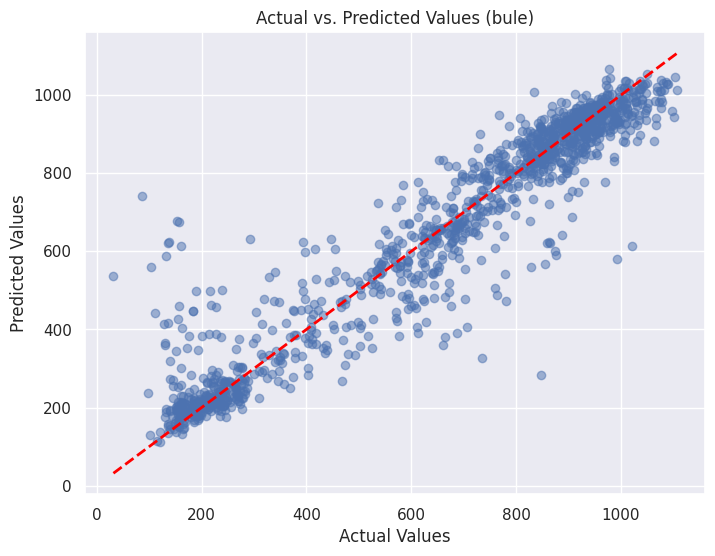

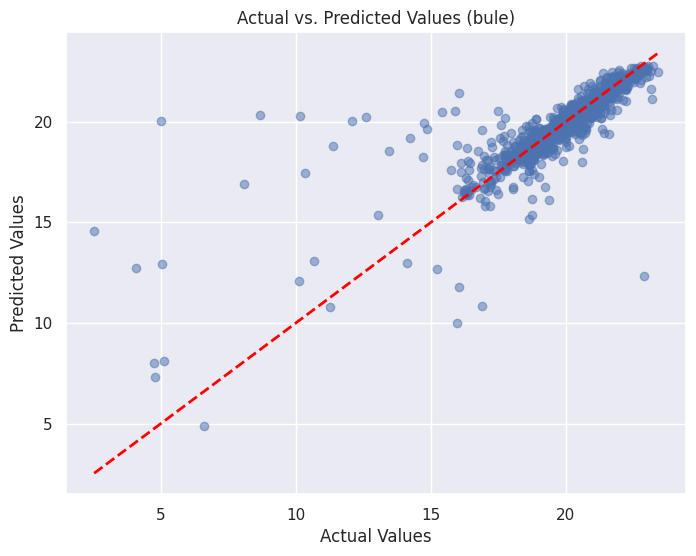

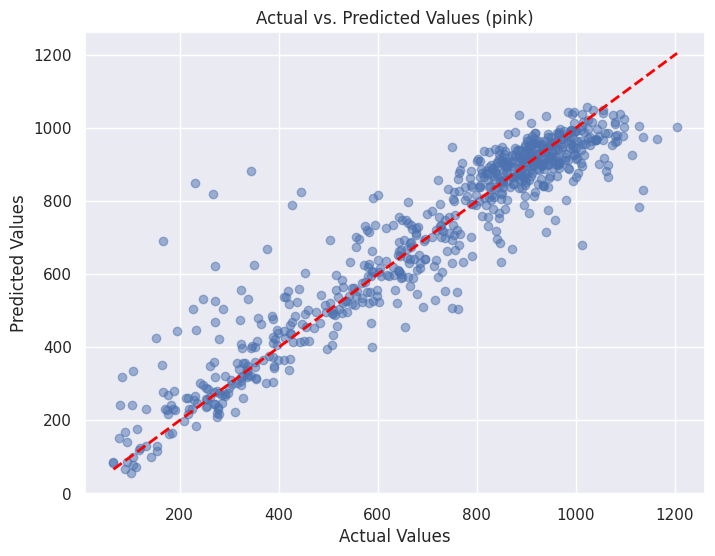

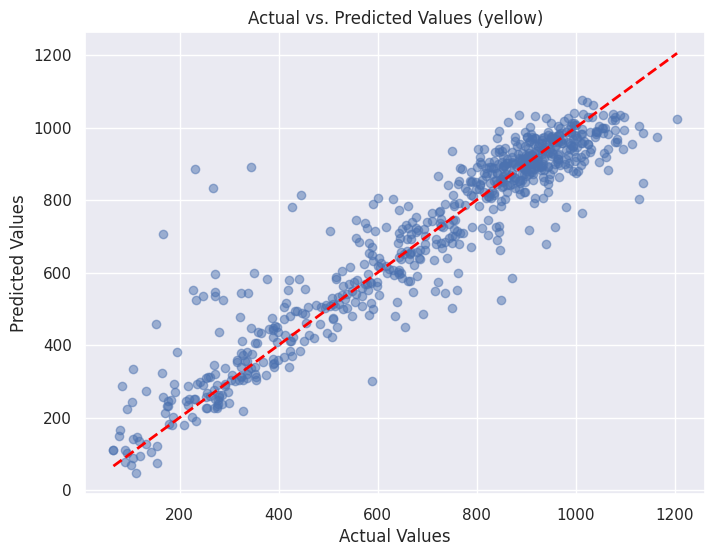

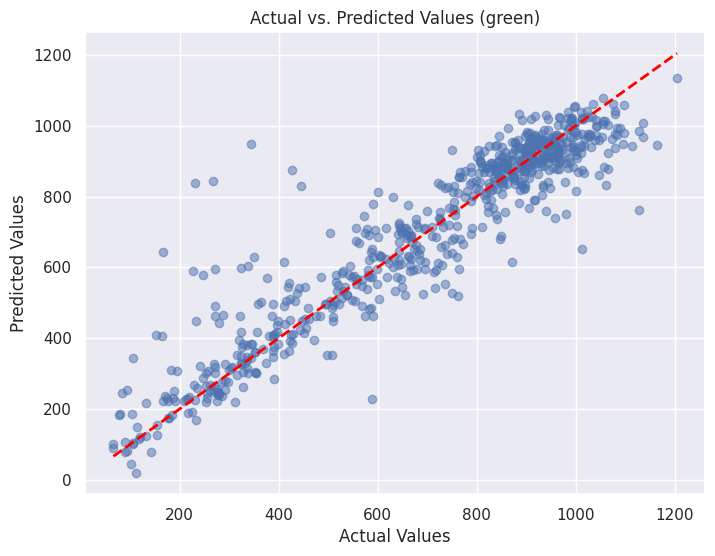

In [ ]:
import matplotlib.pyplot as plt

def plot_actual_vs_predicted(y_test, y_pred, color_label):
    plt.figure(figsize=(8, 6))
    plt.scatter(y_test, y_pred, alpha=0.5)  # Plot actual vs. predicted values
    plt.xlabel("Actual Values")
    plt.ylabel("Predicted Values")
    plt.title(f"Actual vs. Predicted Values ({color_label})")
    # Add a diagonal line for reference (perfect predictions)
    plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red', lw=2)
    plt.show()

# Plot for 'bule' group
plot_actual_vs_predicted(y1_test_bule, y1_pred_bule, 'bule')
plot_actual_vs_predicted(y2_test_bule, y2_pred_bule, 'bule')

# Plot for 'pink' group
plot_actual_vs_predicted(y1_test_pink, y1_pred_pink, 'pink')

# Plot for 'yellow' group
plot_actual_vs_predicted(y1_test_yellow, y1_pred_yellow, 'yellow')

# Plot for 'green' group
plot_actual_vs_predicted(y1_test_green, y1_pred_green, 'green')


## Nueral Network(Speeds of pink area)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Mean Absolute Error: 0.6961415464529538
Mean Squared Error: 1.2595740449933206
R-squared: 0.6064924906687177


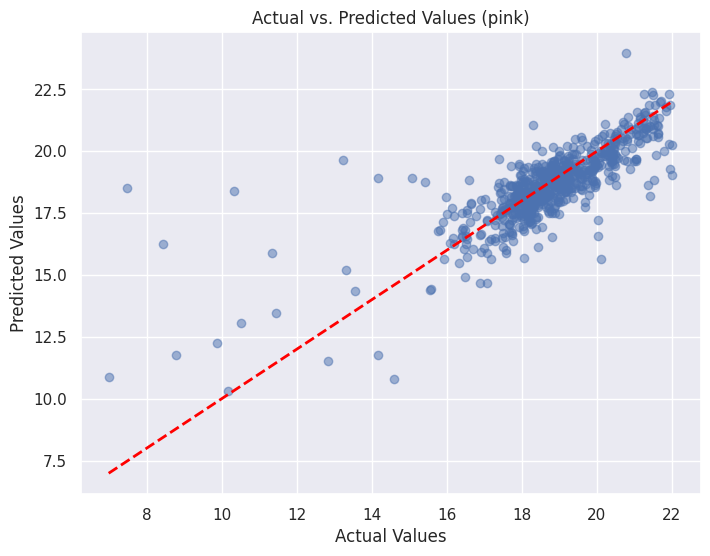

In [ ]:
# pink area
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.layers import LeakyReLU
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Create and compile the model based on the parameters
model = Sequential()
# Instantiate LeakyReLU
leaky_relu = LeakyReLU()
model.add(Dense(64, activation=leaky_relu, input_dim=X_pca_pink.shape[1])) # Use the instantiated LeakyReLU
model.add(Dropout(0.2))
model.add(Dense(64, activation=leaky_relu)) # Use the instantiated LeakyReLU
model.add(Dropout(0.2))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mae', metrics=['mae'])

# Train the model with early stopping and reduced learning rate
early_stop = EarlyStopping(monitor='val_mae', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_mae', factor=0.5, patience=3)
model.fit(X_pca_pink, y2_train_pink, validation_split=0.2, epochs=50, batch_size=64,
    callbacks=[early_stop, reduce_lr], verbose=0)

# Save the model
model.save("speed_model_pink.keras")

# Make predictions
y2_pred_pink = model.predict(X_test_pca_pink)

# Calculate metrics
mae = mean_absolute_error(y2_test_pink, y2_pred_pink)
mse = mean_squared_error(y2_test_pink, y2_pred_pink)
r2 = r2_score(y2_test_pink, y2_pred_pink)

print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")
print(f"R-squared: {r2}")
plot_actual_vs_predicted(y2_test_pink, y2_pred_pink, 'pink')